In [183]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt 
import seaborn as sns 
import plotly as py
import plotly.graph_objs as go
from sklearn.cluster import KMeans, SpectralClustering
from sklearn.preprocessing import MinMaxScaler
import warnings
import os
import math
warnings.filterwarnings("ignore")
#py.offline.init_notebook_mode(connected = True)
#print(os.listdir("../input"))

In [75]:
df = pd.read_csv(r'D:\Data Science Learning\Python\Churn_Modelling.csv')
df.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


In [76]:

# Select duplicate rows except first occurrence based on all columns
duplicateRowsDF = df[df.duplicated()]
print("Duplicate Rows based on a all column are:", duplicateRowsDF, sep='\n')

# Select duplicate rows except first occurrence based on Customer ID
duplicateCustId = df[df.duplicated('CustomerId')]
print("Duplicate Rows based on a CustomerId column are:", duplicateRowsDF, sep='\n')


Duplicate Rows based on a all column are:
Empty DataFrame
Columns: [RowNumber, CustomerId, Surname, CreditScore, Geography, Gender, Age, Tenure, Balance, NumOfProducts, HasCrCard, IsActiveMember, EstimatedSalary, Exited]
Index: []
Duplicate Rows based on a CustomerId column are:
Empty DataFrame
Columns: [RowNumber, CustomerId, Surname, CreditScore, Geography, Gender, Age, Tenure, Balance, NumOfProducts, HasCrCard, IsActiveMember, EstimatedSalary, Exited]
Index: []


In [77]:
#drop the columns that are not relevant to the analysis
#gender might be a valuable variable to consider, but we are
#more interested in understanding the continuous variables
df = df.drop(columns=['RowNumber', 'Surname','Geography','Gender', 'Age', 'HasCrCard','IsActiveMember','EstimatedSalary'])

In [78]:
#separate lost and retained customers
df_lostCust = df[df['Exited'] == 1]
df_retainedCust = df[df['Exited'] == 0]

print(df_retainedCust.shape)
df_retainedCust.head()


(7963, 6)


,CustomerId,CreditScore,Tenure,Balance,NumOfProducts,Exited
1,15647311,608,1,83807.86,1,0
3,15701354,699,1,0.00,2,0
4,15737888,850,2,125510.82,1,0
6,15592531,822,7,0.00,2,0
8,15792365,501,4,142051.07,2,0


In [79]:
df_retainedCust.describe()

,CustomerId,CreditScore,Tenure,Balance,NumOfProducts,Exited
count,7.963000e+03,7963.000000,7963.000000,7963.000000,7963.000000,7963.0
mean,1.569117e+07,651.853196,5.033279,72745.296779,1.544267,0.0
std,7.174423e+04,95.653837,2.880658,62848.040701,0.509536,0.0
min,1.556570e+07,405.000000,0.000000,0.000000,1.000000,0.0
25%,1.562882e+07,585.000000,3.000000,0.000000,1.000000,0.0
50%,1.569154e+07,653.000000,5.000000,92072.680000,2.000000,0.0
75%,1.575335e+07,718.000000,7.000000,126410.280000,2.000000,0.0
max,1.581569e+07,850.000000,10.000000,221532.800000,3.000000,0.0


In [80]:
df_retainedCust = df_retainedCust.drop(columns=['Exited'])


In [81]:
df_retainedCust[df_retainedCust['Balance'] > 0].describe()

,CustomerId,CreditScore,Tenure,Balance,NumOfProducts
count,4.846000e+03,4846.000000,4846.000000,4846.000000,4846.000000
mean,1.569067e+07,652.820264,4.981634,119535.864270,1.360710
std,7.177157e+04,95.784591,2.900175,29944.927372,0.484535
min,1.556570e+07,405.000000,0.000000,14262.800000,1.000000
25%,1.562822e+07,587.000000,2.000000,99118.230000,1.000000
50%,1.569033e+07,655.000000,5.000000,119791.215000,1.000000
75%,1.575307e+07,718.000000,7.000000,139747.397500,2.000000
max,1.581569e+07,850.000000,10.000000,221532.800000,3.000000


In [82]:
#df_retainedCust = df_retainedCust[df_retainedCust['Balance'] > 0]

In [83]:
df_retainedCust.describe()

,CustomerId,CreditScore,Tenure,Balance,NumOfProducts
count,7.963000e+03,7963.000000,7963.000000,7963.000000,7963.000000
mean,1.569117e+07,651.853196,5.033279,72745.296779,1.544267
std,7.174423e+04,95.653837,2.880658,62848.040701,0.509536
min,1.556570e+07,405.000000,0.000000,0.000000,1.000000
25%,1.562882e+07,585.000000,3.000000,0.000000,1.000000
50%,1.569154e+07,653.000000,5.000000,92072.680000,2.000000
75%,1.575335e+07,718.000000,7.000000,126410.280000,2.000000
max,1.581569e+07,850.000000,10.000000,221532.800000,3.000000


In [84]:
df_retainedCust['Balance'] = df_retainedCust['Balance'].apply(lambda x: np.log(x))
df_retainedCust['CreditScore'] = df_retainedCust['CreditScore'].apply(lambda x: np.log(x))


In [85]:

df_retainedCust['Balance'] = df_retainedCust['Balance'].replace(-np.Inf, 0)
df_retainedCust['Balance']


1       11.336282
3        0.000000
4       11.740147
6        0.000000
8       11.863942
          ...    
9993    11.951570
9994     0.000000
9995     0.000000
9996    10.957270
9999    11.776388
Name: Balance, Length: 7963, dtype: float64

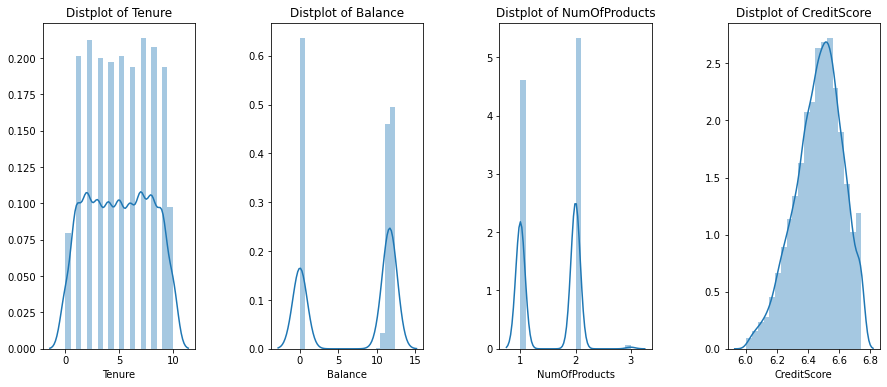

In [86]:
plt.figure(1 , figsize = (15 , 6))
n = 0 
for x in ['Tenure' , 'Balance' , 'NumOfProducts', 'CreditScore']:
    n += 1
    plt.subplot(1 , 4 , n)
    plt.subplots_adjust(hspace =0.5 , wspace = 0.5)
    sns.distplot(df_retainedCust[x] , bins = 20)
    plt.title('Distplot of {}'.format(x))
plt.show()

# retained customers tend to do not seem to be affected by age
# retained customers tend not to have zero balance accounts
# retained customers typically have more than 1 product

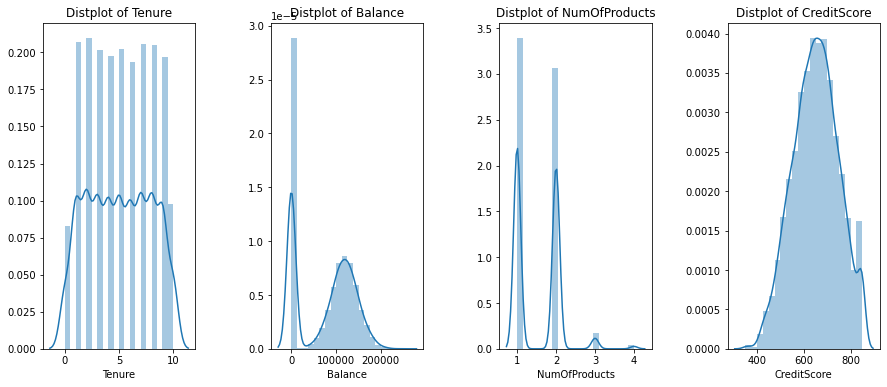

In [87]:
plt.figure(1 , figsize = (15 , 6))
n = 0 
for x in ['Tenure' , 'Balance' , 'NumOfProducts', 'CreditScore']:
    n += 1
    plt.subplot(1 , 4 , n)
    plt.subplots_adjust(hspace =0.5 , wspace = 0.5)
    sns.distplot(df[x] , bins = 20)
    plt.title('Distplot of {}'.format(x))
plt.show()

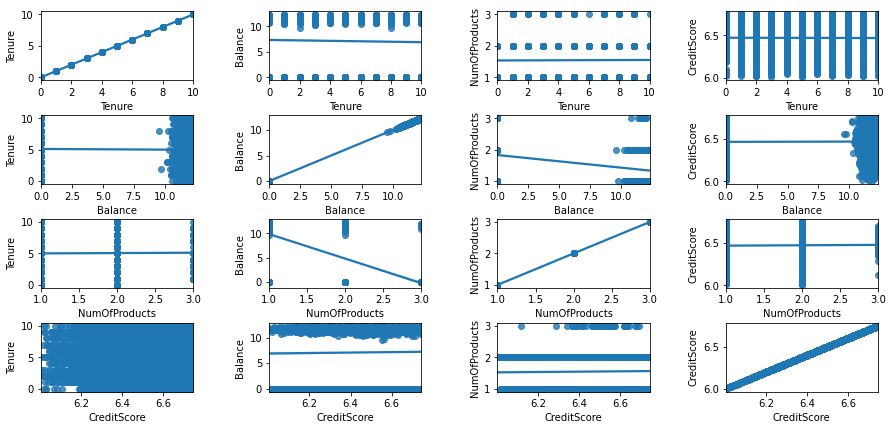

In [127]:
plt.figure(1 , figsize = (15 , 7))
n = 0 
for x in ['Tenure' , 'Balance' , 'NumOfProducts', 'CreditScore']:
    for y in ['Tenure' , 'Balance' , 'NumOfProducts', 'CreditScore']:
        n += 1
        plt.subplot(4 , 4 , n)
        plt.subplots_adjust(hspace = 0.5 , wspace = 0.5)
        sns.regplot(x = x , y = y , data = df_retainedCust)
        plt.ylabel(y.split()[0]+' '+y.split()[1] if len(y.split()) > 1 else y )
plt.show()

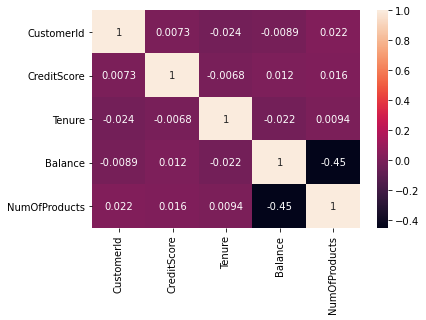

In [185]:
sns.heatmap(df_retainedCust.corr(), annot=True)
plt.show()

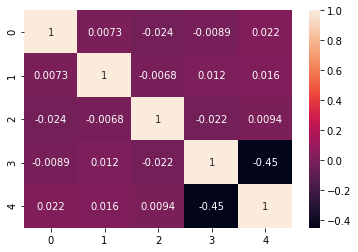

In [188]:
#Scaling does not make a difference in calculating correlation
df_retainedCust_scaled = apply_MinMaxScale(df_retainedCust)
df_3 = pd.DataFrame(data=df_retainedCust_scaled)
sns.heatmap(df_3.corr(), annot=True)
plt.show()

In [180]:
def apply_MinMaxScale(unscaled_ndarray):
    mms = MinMaxScaler()
    scaled_ndarray = mms.fit_transform(unscaled_ndarray)
    return scaled_ndarray


In [182]:
'''Balance and NumOfProducts'''
X1 = df_retainedCust[['Balance' , 'NumOfProducts']].iloc[: , :].values
X1_scaled = apply_MinMaxScale(X1)

'''Balance and CreditScore'''
X2 = df_retainedCust[['Balance' , 'CreditScore']].iloc[: , :].values
X2_scaled = apply_MinMaxScale(X2)



In [168]:
def build_kmeanDistortions(scaled_ndarray):
    distortions = []
    K = range(1,11)
    for n in K:
        kmeanModel = (KMeans(n_clusters = n ,init='k-means++', n_init = 10 ,max_iter=300, 
                            tol=0.0001,  random_state= 111  , algorithm='elkan') )
        kmeanModel.fit(scaled_ndarray)
        distortions.append(kmeanModel.inertia_)
    return distortions

In [173]:
def plot_kmeanClusters(distortions):
    plt.figure(1 , figsize = (15 ,6))
    plt.plot(np.arange(1 , 11) , distortions , 'o')
    plt.plot(np.arange(1 , 11) , distortions , '-' , alpha = 0.5)
    plt.xlabel('Number of Clusters') , plt.ylabel('Distortion')
    plt.show()

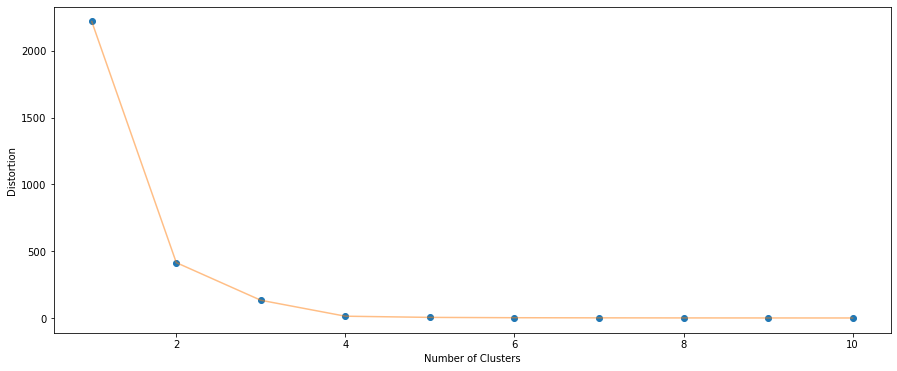

In [174]:
distortion_01 = build_kmeanDistortions(X1_transformed)
plot_kmeanClusters(distortion_01)


In [273]:
kmean_labels = np.array([])
kmean_centroids = np.array([])
kmeanModel = KMeans()

def build_kmeanModel(scaled_ndarray, best_n_clusters):
    global kmean_labels
    global kmean_centroids
    global kmeanModel

    kmeanModel = (KMeans(n_clusters = best_n_clusters ,init='k-means++', n_init = 10 ,max_iter=300, 
                            tol=0.0001,  random_state= 111  , algorithm='elkan') )
    kmeanModel.fit(scaled_ndarray)
    kmean_labels = kmeanModel.labels_
    kmean_centroids = kmeanModel.cluster_centers_


In [276]:
build_kmeanModel(X1_scaled, 3)

In [294]:

def build_plotVariables(scaled_ndarray, kmeanModel):
    global x, y
    global x_min, x_max, y_min, y_max
    global xx, yy
    global Z
    global df_plot

    h = 0.01

    x = scaled_ndarray[:,0]
    y = scaled_ndarray[:,1]
    x_min, x_max = scaled_ndarray[:, 0].min() - 1, scaled_ndarray[:, 0].max() + 1
    y_min, y_max = scaled_ndarray[:, 1].min() - 1, scaled_ndarray[:, 1].max() + 1

    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
    Z = kmeanModel.predict(np.c_[xx.ravel(), yy.ravel()]) 
    Z = Z.reshape(xx.shape)
#


In [300]:
build_plotVariables(X1_scaled, kmeanModel)

In [302]:
def plot_2DKmeans(x_axis_name, y_axis_name):
    plt.figure(1 , figsize = (10 , 7) )
    plt.clf()

    plt.imshow(Z , interpolation='nearest', 
            extent=(xx.min(), xx.max(), yy.min(), yy.max()),
            cmap = plt.cm.Pastel2, aspect = 'auto', origin='lower')

    plt.scatter(x, y , c = kmean_labels , s = 200 )
    plt.scatter(x = kmean_centroids[: , 0] , y =  kmean_centroids[: , 1] , s = 300 , c = 'red' , alpha = 0.5)

    plt.xlabel(x_axis_name)
    plt.ylabel(y_axis_name) 
    plt.show()

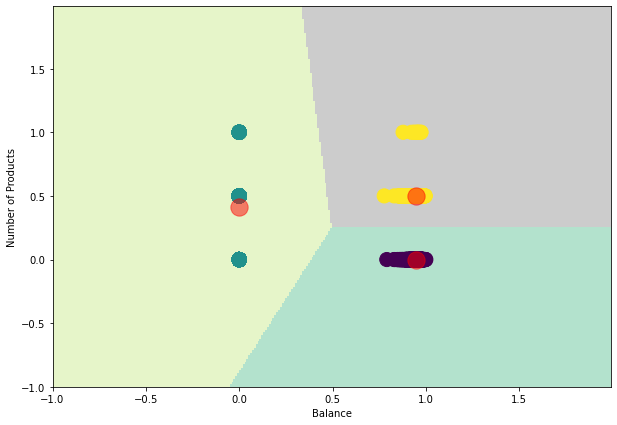

In [303]:
plot_2DKmeans('Balance', 'Number of Products')

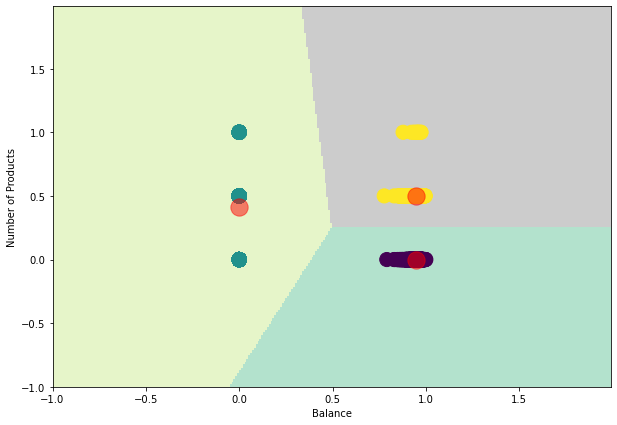

In [293]:
'''Balance and NumOfProducts'''
plt.figure(1 , figsize = (10 , 7) )
plt.clf()
Z = Z.reshape(xx.shape)

plt.imshow(Z , interpolation='nearest', 
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap = plt.cm.Pastel2, aspect = 'auto', origin='lower')

plt.scatter(x, y , c = kmean_labels , s = 200 )
plt.scatter(x = kmean_centroids[: , 0] , y =  kmean_centroids[: , 1] , s = 300 , c = 'red' , alpha = 0.5)

plt.ylabel('Number of Products') , plt.xlabel('Balance')
plt.show()

In [ ]:

    h = 0.01
    x_min, x_max = X1_transformed[:, 0].min() - 1, X1_transformed[:, 0].max() + 1
    y_min, y_max = X1_transformed[:, 1].min() - 1, X1_transformed[:, 1].max() + 1

    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
    Z = algorithm.predict(np.c_[xx.ravel(), yy.ravel()]) 

In [209]:
df_2 = pd.DataFrame(data=X1_transformed)
df_2.columns = ['Balance','NumOfProducts']

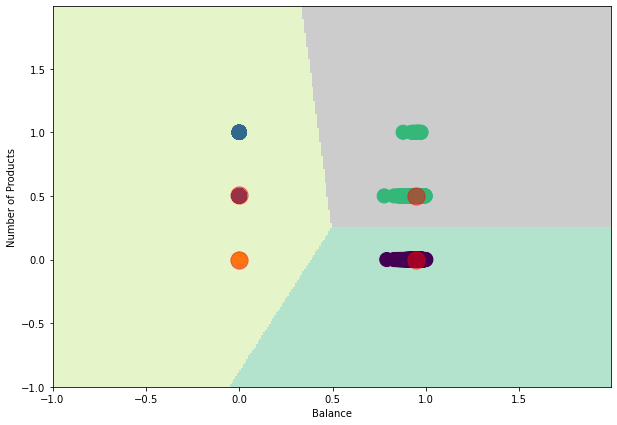

In [280]:
'''Balance and NumOfProducts'''
plt.figure(1 , figsize = (10 , 7) )
plt.clf()
Z = Z.reshape(xx.shape)

plt.imshow(Z , interpolation='nearest', 
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap = plt.cm.Pastel2, aspect = 'auto', origin='lower')

plt.scatter( x = 'Balance', y = 'NumOfProducts' , data = df_2 , c = labels1 , s = 200 )

plt.scatter(x = centroids[: , 0] , y =  centroids[: , 1] , s = 300 , c = 'red' , alpha = 0.5)
plt.ylabel('Number of Products') , plt.xlabel('Balance')
plt.show()

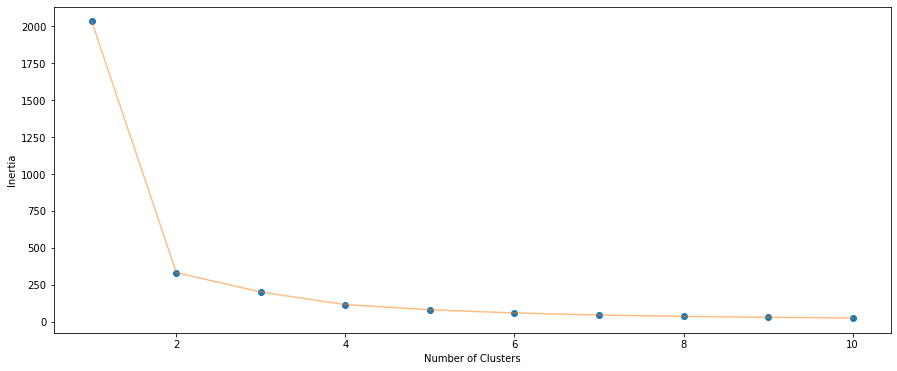

In [146]:
plt.figure(1 , figsize = (15 ,6))
plt.plot(np.arange(1 , 11) , inertia2 , 'o')
plt.plot(np.arange(1 , 11) , inertia2 , '-' , alpha = 0.5)
plt.xlabel('Number of Clusters') , plt.ylabel('Inertia')
plt.show()

In [147]:
algorithm2 = (KMeans(n_clusters = 3 ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
algorithm2.fit(X2_transformed)
labels2 = algorithm2.labels_
centroids2 = algorithm2.cluster_centers_
print(algorithm2.labels_)

[2 1 0 ... 1 2 0]


In [282]:
h = 0.02
x_min, x_max = X2_transformed[:, 0].min() - 1, X2_transformed[:, 0].max() + 1
y_min, y_max = X2_transformed[:, 1].min() - 1, X2_transformed[:, 1].max() + 1

xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
Z = algorithm2.predict(np.c_[xx.ravel(), yy.ravel()]) 

In [154]:
df_X2 = pd.DataFrame(data=X2_transformed    # values
 #            index=X1_transformed[1:,0],    # 1st column as index
          )  # 1st row as the column names
df_X2.columns = ['Balance','CreditScore']

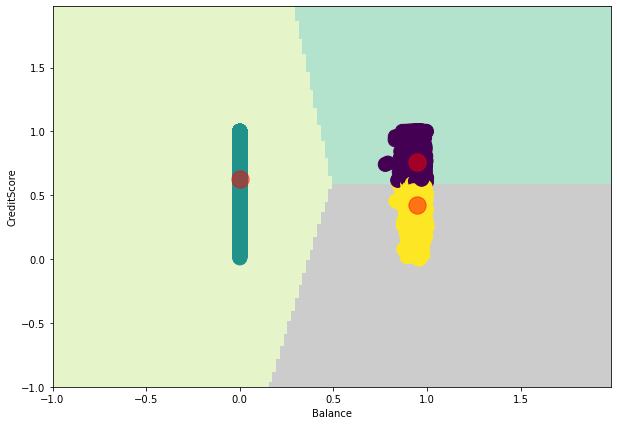

In [284]:
'''Balance and NumOfProducts'''
plt.figure(1 , figsize = (10 , 7) )
plt.clf()
Z = Z.reshape(xx.shape)
plt.imshow(Z , interpolation='nearest', 
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap = plt.cm.Pastel2, aspect = 'auto', origin='lower')


plt.scatter( x = 'Balance', y = 'CreditScore' , data = df_X2 , c = labels2 , s = 200 )


plt.scatter(x = centroids2[: , 0] , y =  centroids2[: , 1] , s = 300 , c = 'red' , alpha = 0.5)
plt.ylabel('CreditScore') , plt.xlabel('Balance')
plt.show()